In [1]:
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt

import umap

from collections import Counter

import spacy

# load files and make corpus

In [2]:
with open('hansard-speeches-post2010-lemmatized-agg.pkl', 'rb') as f:
    df = pickle.load(f)

In [3]:
with open('hansard-speeches-post2010.pkl', 'rb') as f:
    df_orig = pickle.load(f)

In [4]:
MP_party = df_orig[['display_as', 'party']]
MP_party = MP_party.drop_duplicates('display_as').set_index('display_as')

In [5]:
names = [x[2] for x in df.index.values]
parties = [MP_party.loc[MP_name].party for MP_name in names]

In [6]:
corpus = list(df.speech.values)
# corpus = list(df.lemmas.apply(lambda x: " ".join(x)).values)

# speech embedding

In [7]:
from sentence_transformers import SentenceTransformer

# embedder = SentenceTransformer('paraphrase-MiniLM-L6-v2')
embedder = SentenceTransformer('paraphrase-mpnet-base-v2')
# embedder = SentenceTransformer('stsb-mpnet-base-v2') #75 max seq length

## count prop. contributions with word/lemma counts above embedder max input sequence length

max sequence length: 128
wordcounts above 128: 33.859 %
lemmacounts above 128: 22.3926 %


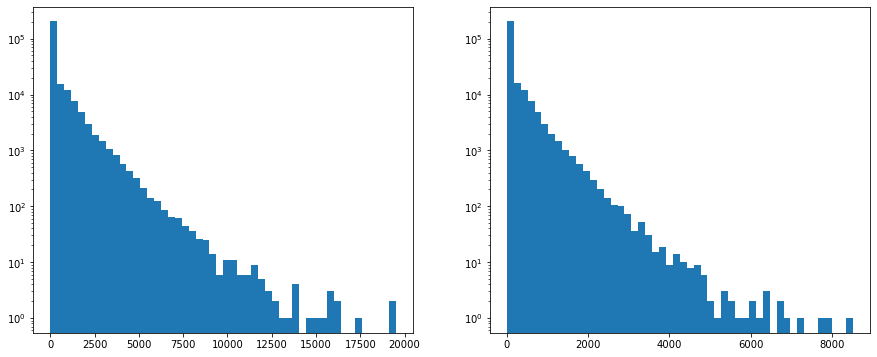

In [8]:
wordcount = df.speech.apply(lambda x: len(x.split())).values
lemmacount = df.lemmas.apply(len).values

max_seq_len = embedder.max_seq_length
print(f'max sequence length: {max_seq_len}')

fig, ax = plt.subplots(1,2,figsize=(15,6))

ax[0].hist(wordcount, bins=50)
ax[0].set_yscale('log')
print(f'wordcounts above {max_seq_len}: {np.around((np.sum(wordcount > max_seq_len) / len(wordcount))*100, 4)} %')

ax[1].hist(lemmacount, bins=50)
ax[1].set_yscale('log')
print(f'lemmacounts above {max_seq_len}: {np.around((np.sum(lemmacount > max_seq_len) / len(lemmacount))*100, 4)} %')

plt.show()

In [9]:
# don't run if loading embeddings
# corpus_embeddings = embedder.encode(corpus)
# corpus_embeddings = corpus_embeddings /  np.linalg.norm(corpus_embeddings, axis=1, keepdims=True)

In [11]:
# don't run if loading embeddings
# with open('corpus_embeddings.pkl', 'wb') as f:
#     pickle.dump(corpus_embeddings, f)

# run to load embeddings
with open('corpus_embeddings.pkl', 'rb') as f:
    corpus_embeddings = pickle.load(f)

In [12]:
corpus_embeddings.shape

(253820, 768)

## PCA dimensionality reduction

In [13]:
np.random.seed(26)

In [14]:
from sklearn.decomposition import PCA
pca = PCA(random_state=26)
pca.fit(corpus_embeddings)

PCA(random_state=26)

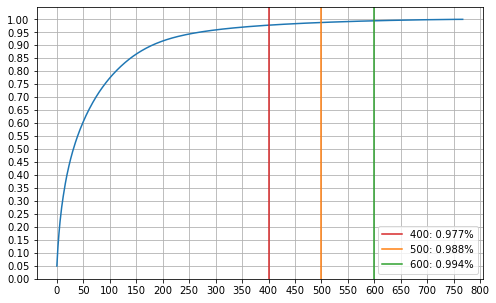

In [15]:
evr = pca.explained_variance_ratio_
cum_evr = [np.sum(evr[:i+1]) for i in range(len(evr))]

fig, ax = plt.subplots(figsize=(8,5))
ax.plot(cum_evr)
ax.grid()
ax.set_xticks(range(0,801,50))
ax.set_yticks(np.arange(0,1.05,0.05))

v = 400
ax.axvline(v, c='tab:red', label=f'{v}: {np.around(cum_evr[v], 3)}%')

v = 500
ax.axvline(v, c='tab:orange', label=f'{v}: {np.around(cum_evr[v], 3)}%')

v = 600
ax.axvline(v, c='tab:green', label=f'{v}: {np.around(cum_evr[v], 3)}%')

ax.legend()

plt.show()

In [ ]:
# don't run if loading embeddings
# embeddings = PCA(n_components=500, random_state=26).fit_transform(corpus_embeddings)

## umap dimensionality reduction

In [16]:
np.unique(parties)

array(['Alliance', 'Conservative', 'Democratic Unionist Party',
       'Green Party', 'Independent', 'Labour', 'Labour (Co-op)',
       'Liberal Democrat', 'Plaid Cymru', 'Respect',
       'Scottish National Party', 'Social Democratic & Labour Party',
       'Speaker', 'Ulster Unionist Party', 'nan'], dtype='<U32')

In [17]:
party_colormap = {
    'Alliance': '#F6CB2F',
    'Conservative': '#0087DC',
    'Democratic Unionist Party': '#D46A4C',
    'Green Party': '#6AB023',
    'Independent': '#DDDDDD',
    'Labour': '#E4003B',
    'Labour (Co-op)': '#E4003B',
    'Liberal Democrat': '#FAA61A',
    'Plaid Cymru': '#008142',
    'Scottish National Party': '#FDF38E',
    'Social Democratic & Labour Party': '#2AA82C',
    'Speaker': '#FFFFFF',
    'Respect': '#46801c',
    'Ulster Unionist Party': '#70147A',
    'nan': '#FFFFFF'
}

c = [party_colormap[str(x)] for x in parties]

In [ ]:
# don't run if loading reduced embeddings
# reducer = umap.UMAP(n_neighbors=15, 
#                     min_dist=0,
#                     metric='cosine',
#                     low_memory=True)
# X = reducer.fit_transform(embeddings) # dimension reduced embedding

In [18]:
# don't run if loading reduced embeddings
# with open('umap_embeddings.pkl', 'wb') as f:
#     pickle.dump(X, f)

# run to load reduced embeddings
with open('umap_embeddings.pkl', 'rb') as f:
    X = pickle.load(f)

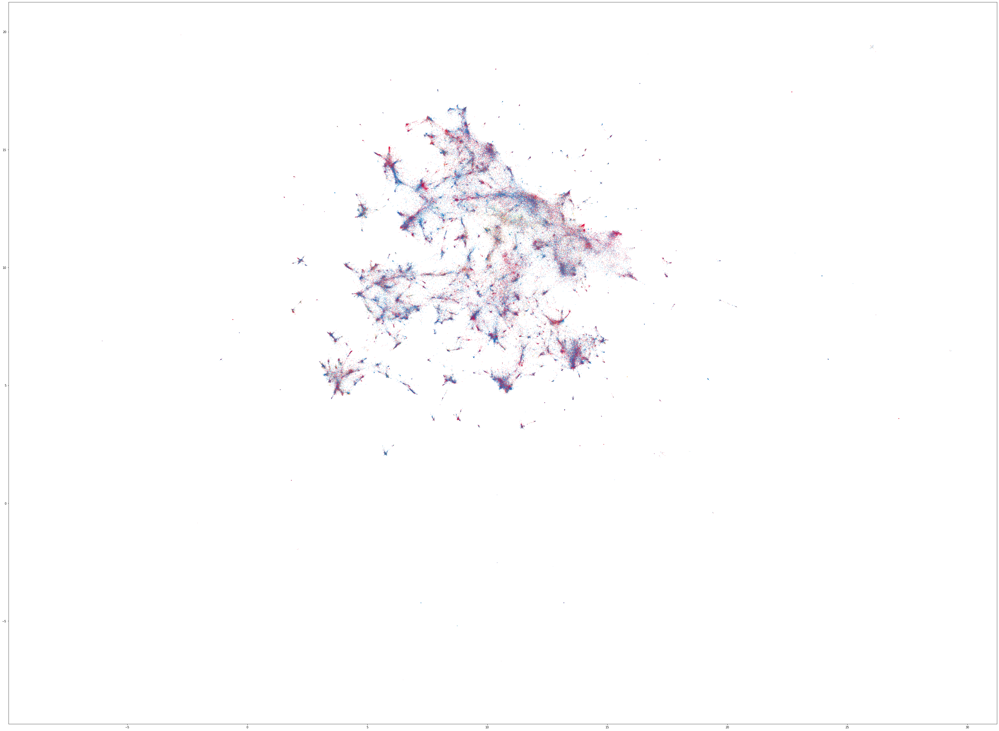

In [19]:
plt.figure(figsize=(60,45))
plt.scatter(X[:,0], X[:,1], s=1, alpha=.2, c=c)#, edgecolors='k', linewidth=0)
# plt.savefig('pp-mpnet-bv2-pca400-nn15-md0-cosine_2.png', dpi=150)
plt.show()

# clustering

In [20]:
import hdbscan
clusterer = hdbscan.HDBSCAN(min_cluster_size=10,
                            min_samples=5,
                            cluster_selection_epsilon=0.018,
                            cluster_selection_method='eom')

cluster_labels = clusterer.fit_predict(X)

these parameters tuned manually - for this dataset captures clusters of different sizes and densities well

In [21]:
label_map = np.random.choice(np.arange(len(np.unique(cluster_labels)) - 1), 
                             len(np.unique(cluster_labels)) - 1,
                             replace=False)
label_map = {o:n for o,n in zip(np.arange(len(label_map)), label_map)}
label_map[-1] = -1

cluster_labels = np.array([label_map[x] for x in cluster_labels])

<ipython-input-22-d4b63170898d>:2: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("rainbow"))
  cmap.set_under('black')  # Color for values less than vmin


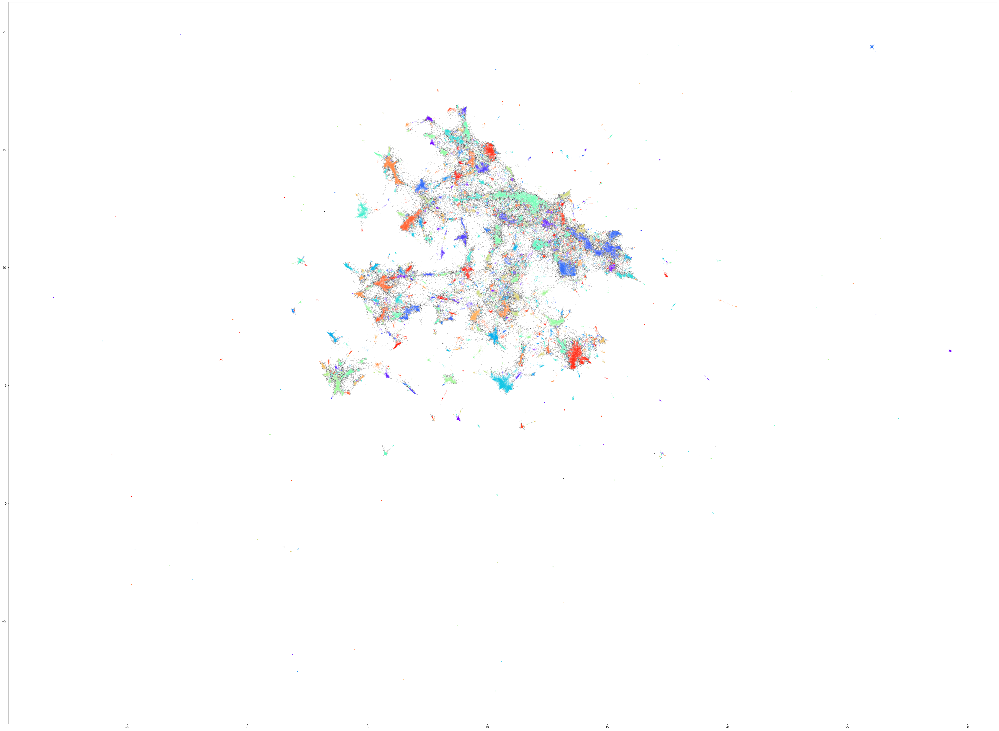

In [22]:
cmap = plt.get_cmap('rainbow')
cmap.set_under('black')  # Color for values less than vmin

plt.figure(figsize=(60,45))
plt.scatter(X[:,0], X[:,1], 
            s=1, alpha=.2, c=cluster_labels,
            cmap=cmap, vmin=0)#, edgecolors='k', linewidth=0)
# plt.savefig('pp-mpnet-bv2-pca400-nn15-md0-cosine_hdbscan4.png', dpi=200)
plt.show()

# ploty: interactive scatter & centroids

In [23]:
df_proj = pd.DataFrame(X)
df_proj['cluster'] = cluster_labels

In [24]:
df_proj

,0,1,cluster
0,13.945630,10.280601,-1
1,15.464976,11.090725,562
2,14.197853,11.004829,217
3,13.692422,6.981069,-1
4,9.666830,8.136745,1290
...,...,...,...
253815,13.908275,9.806657,920
253816,13.320908,9.673240,253
253817,13.597217,10.076688,253
253818,11.909001,12.478726,821


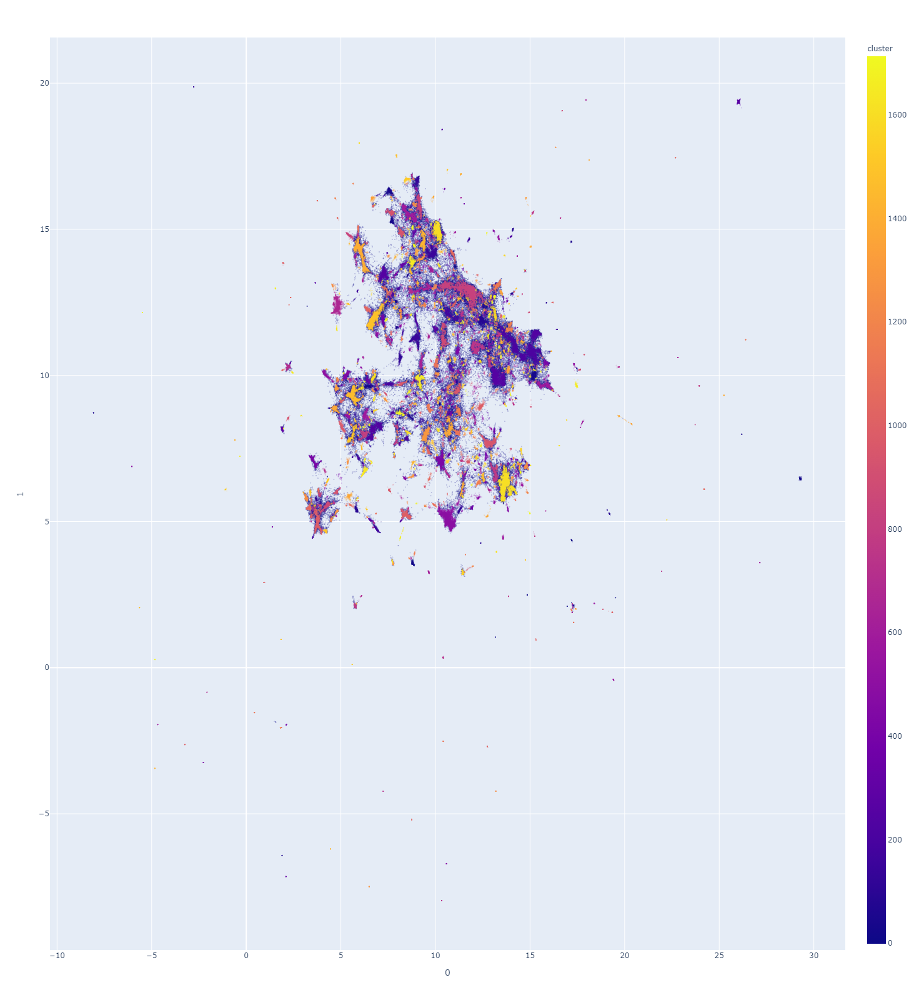

In [25]:
import plotly.express as px
fig = px.scatter(df_proj, x=0, y=1, 
                 opacity=0.2,
                 color='cluster', hover_data=['cluster'],
                 height=1600, width=2400)
fig.update_traces(marker=dict(size=2),
                  selector=dict(mode='markers'))
fig.write_html("clustered_embeddings.html")
fig.show()

In [26]:
df_clusters = df_proj.groupby('cluster').agg({0: ['mean'], 1: ['mean'], 'cluster':[len]})

In [27]:
X_centroids = df_clusters[[0,1]].values[1:]
cluster_size = df_clusters['cluster'].values[1:]

In [ ]:
# fig, ax = plt.subplots(figsize=(90,90))
# ax.scatter(X_centroids[:,0], X_centroids[:,1], s=cluster_size*3, alpha=0.2)
# for i, txt in enumerate(df_clusters.index.values[1:]):
#     ax.annotate(txt, 
#                 (X_centroids[i,0], X_centroids[i,1]),
#                 ha='center', va='center',
#                 fontsize=10,
#                 alpha=0.5
#                )
# plt.savefig('pp-mpnet-bv2-pca500-nn15-md0-cosine_centroids.png')

# cluster speeches EDA

In [28]:
df['cluster'] = cluster_labels

In [29]:
df

speech  \
date       heading                                           display_as                                                           
2010-05-25 DEPUTY SPEAKERS Debate on the Address — [1st Day] Alan Beith       I usually enjoy and can be quite entertained b...   
                                                             Alan Haselhurst  Order. I should remind the hon. Gentleman and ...   
                                                             Andrew Miller    On a point of order, Mr. Speaker.It might help...   
                                                             Andrew Selous    I want to pick the right hon. Gentleman up on ...   
                                                             Andrew Smith     Would not Government members do well to rememb...   
...                                                                                                                         ...   
2019-11-05 Valedictory Debate                                Stephen Pound    May I begin by apologising, Madam Deputy Speak...   
                                                             Stephen Twigg    It is a pleasure to follow the hon. Member for...   
                                                             Teresa Pearce    I would like to thank my fantastic family, my ...   
                                                             Tim Loughton     I am very concerned and upset about my right h...   
                                                             Valerie Vaz      Thank you, Mr Speaker. I congratulate you on y...   

                                                                                                                         lemmas  \
date       heading                                           display_as                                                           
2010-05-25 DEPUTY SPEAKERS Debate on the Address — [1st Day] Alan Beith       [usually, enjoy, entertain, speech, right, hon...   
                                                             Alan Haselhurst  [order, remind, hon, gentleman, house, interve...   
                                                             Andrew Miller    [point, order, speaker, help, house, particula...   
                                                             Andrew Selous    [want, pick, right, hon, gentleman, different,...   
                                                             Andrew Smith     [government, member, remember, fine, line, div...   
...                                                                                                                         ...   
2019-11-05 Valedictory Debate                                Stephen Pound    [begin, apologise, madam, deputy, speaker, nor...   
                                                             Stephen Twigg    [pleasure, follow, hon, member, north, devon, ...   
                                                             Teresa Pearce    [like, thank, fantastic, family, friend, staff...   
                                                             Tim Loughton     [concerned, upset, right, hon, friend, departu...   
                                                             Valerie Vaz      [thank, mr, speaker, congratulate, victory, kn...   

                                                                              cluster  
date       heading                                           display_as                
2010-05-25 DEPUTY SPEAKERS Debate on the Address — [1st Day] Alan Beith            -1  
                                                             Alan Haselhurst      562  
                                                             Andrew Miller        217  
                                                             Andrew Selous         -1  
                                                             Andrew Smith        1290  
...                                                                               ...  
2019-11-0

In [30]:
groups = df.groupby('cluster')

In [31]:
df_cluster_lemmas = groups.agg({'lemmas': list})

In [32]:
def flatten(list_of_lists):
    res = []
    for l in list_of_lists:
        res += l
    return res

def flatten_lemmas(el):
    return flatten(el.values.ravel()[0])

In [33]:
cluster_lemmas = df_cluster_lemmas.apply(flatten_lemmas, axis=1)

## tfidf each cluster's lemmas

In [34]:
def plot_cluster_freq(i, use_top_word=True):
    if use_top_word:
        label = cluster_vocab[i][0]
    else:
        label = i
    df[df.cluster==i].reset_index().set_index('date').resample('M').agg('count').rename(columns={'heading':label})[label].plot()

In [35]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [36]:
cluster_lemmas_joined = cluster_lemmas.apply(lambda x: " ".join(x))

In [37]:
vectorizer = TfidfVectorizer(max_df=0.8)
cluster_tfidf = vectorizer.fit_transform(cluster_lemmas_joined)

In [38]:
# # with open('cluster_tfidf.pkl', 'wb') as f:
# #     pickle.dump(cluster_tfidf, f)

# with open('cluster_tfidf.pkl', 'rb') as f:
#     cluster_tfidf = pickle.load(f)

In [39]:
cluster_tfidf.shape

(1715, 113877)

In [40]:
top_vocab_inds = []
non_zero = []
n = 50
for i in range(cluster_tfidf.shape[0]):
    row = cluster_tfidf.getrow(i).toarray().ravel()
    non_zero.append(np.sum(row > 0))
    top_vocab_inds.append(row.argsort()[::-1][:n])
    if i % 100 == 0:
        print(f'done {i}')

done 0
done 100
done 200
done 300
done 400
done 500
done 600
done 700
done 800
done 900
done 1000
done 1100
done 1200
done 1300
done 1400
done 1500
done 1600
done 1700


In [41]:
non_zero = np.array(non_zero)

In [42]:
np.sum(non_zero < n)

65

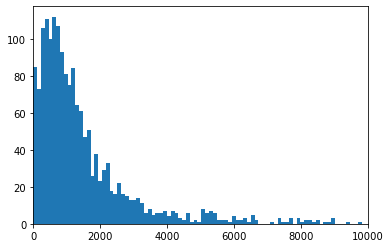

In [43]:
plt.hist(non_zero, bins=500)
plt.xlim((0,10000))
plt.show()

In [44]:
id_to_w = {v:k for k,v in vectorizer.vocabulary_.items()}

In [45]:
top_vocab_words = np.vectorize(id_to_w.get)(top_vocab_inds)

In [46]:
top_vocab_words = [x[:l] for x,l in zip(top_vocab_words, non_zero)]
cluster_vocab = {k:v for k,v in zip(np.arange(len(top_vocab_words))-1, top_vocab_words)}

In [47]:
cluster_vocab[937]

array(['disabled', 'disability', 'pip', 'assessment', 'benefit', 'esa',
       'claimant', 'employment', 'allowance', 'health', 'dla', 'appeal',
       'atos', 'condition', 'payment', 'mental', 'department',
       'constituent', 'cut', 'motability', 'capability', 'dwp',
       'decision', 'process', 'care', 'pensions', 'independence',
       'system', 'welfare', 'personal', 'universal', 'living', 'mobility',
       'credit', 'review', 'employer', 'access', 'receive', 'lady',
       'social', 'group', 'child', 'impact', 'reform', 'million',
       'programme', 'remploy', 'job', 'reconsideration', 'claim'],
      dtype='<U22')

In [48]:
cluster_vocab[350]

array(['disabled', 'station', 'transport', 'bus', 'passenger', 'access',
       'disability', 'accessible', 'accessibility', 'train', 'taxi',
       'rail', 'wheelchair', 'kidsgrove', 'dog', 'guide', 'pavement',
       'dogs', 'travel', 'parking', 'railway', 'driver', 'inclusive',
       'blind', 'visual', 'local', 'audio', 'strategy', 'journey',
       'visually', 'network', 'funding', 'department', 'impairment',
       'training', 'bill', 'authority', 'operator', 'user', 'step',
       'space', 'million', 'free', 'impair', 'constituency', 'platform',
       'london', 'lady', 'mobility', 'vehicle'], dtype='<U22')

In [ ]:
cluster_vocab[1266]

In [ ]:
cluster_vocab[267]

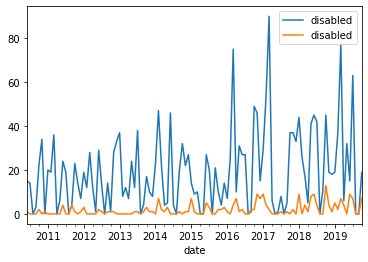

In [49]:
plot_cluster_freq(937)
plot_cluster_freq(350)
plt.legend()
plt.show()

In [ ]:
Counter(cluster_labels).most_common()[:10]

In [ ]:
df[df.cluster==760]

In [ ]:
i = 760
plot_cluster_freq(i)
cluster_vocab[i]

In [ ]:
# for i, vocab in cluster_vocab.items():
#     print(i, vocab[:10], '\n')